In [15]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
import pandas as pd
import seaborn as sns
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import Pipeline
from catboost import CatBoostRegressor
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_validate
plt.rcParams['figure.figsize'] = (14,8)


EDA

In [16]:
bikes = pd.read_csv ('/mnt/c/Users/noram/Documents/Coding/SpicedAcademy/Week03/train.csv', parse_dates=True, index_col=0)
bikes

,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,casual,registered,count
datetime,,,,,,,,,,,
2011-01-01 00:00:00,1,0,0,1,9.84,14.395,81,0.0000,3,13,16
2011-01-01 01:00:00,1,0,0,1,9.02,13.635,80,0.0000,8,32,40
2011-01-01 02:00:00,1,0,0,1,9.02,13.635,80,0.0000,5,27,32
2011-01-01 03:00:00,1,0,0,1,9.84,14.395,75,0.0000,3,10,13
2011-01-01 04:00:00,1,0,0,1,9.84,14.395,75,0.0000,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...
2012-12-19 19:00:00,4,0,1,1,15.58,19.695,50,26.0027,7,329,336
2012-12-19 20:00:00,4,0,1,1,14.76,17.425,57,15.0013,10,231,241
2012-12-19 21:00:00,4,0,1,1,13.94,15.910,61,15.0013,4,164,168


In [17]:
bikes.isna().any()

season        False
holiday       False
workingday    False
weather       False
temp          False
atemp         False
humidity      False
windspeed     False
casual        False
registered    False
count         False
dtype: bool

In [18]:
bikes.drop(['casual','registered'], axis=1, inplace=True)
bikes

,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,count
datetime,,,,,,,,,
2011-01-01 00:00:00,1,0,0,1,9.84,14.395,81,0.0000,16
2011-01-01 01:00:00,1,0,0,1,9.02,13.635,80,0.0000,40
2011-01-01 02:00:00,1,0,0,1,9.02,13.635,80,0.0000,32
2011-01-01 03:00:00,1,0,0,1,9.84,14.395,75,0.0000,13
2011-01-01 04:00:00,1,0,0,1,9.84,14.395,75,0.0000,1
...,...,...,...,...,...,...,...,...,...
2012-12-19 19:00:00,4,0,1,1,15.58,19.695,50,26.0027,336
2012-12-19 20:00:00,4,0,1,1,14.76,17.425,57,15.0013,241
2012-12-19 21:00:00,4,0,1,1,13.94,15.910,61,15.0013,168


In [19]:
months = bikes.index.month
months

Int64Index([ 1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
            ...
            12, 12, 12, 12, 12, 12, 12, 12, 12, 12],
           dtype='int64', name='datetime', length=10886)

In [20]:
mMonths = bikes.groupby(months).mean()
mMonths

,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,count
datetime,,,,,,,,,
1,1.0,0.080317,0.622172,1.400452,9.840000,12.077579,55.911765,14.582959,90.366516
2,1.0,0.000000,0.708102,1.458380,11.798535,14.532608,56.296337,13.963707,110.003330
3,1.0,0.000000,0.710322,1.413984,15.902175,19.017220,56.678135,15.363249,148.169811
4,2.0,0.052805,0.656766,1.432343,18.718372,22.305891,55.697470,15.581090,184.160616
5,2.0,0.000000,0.736842,1.527412,22.674079,26.632374,68.084430,12.293956,219.459430
6,2.0,0.000000,0.684211,1.309211,27.064496,30.988750,58.759868,12.348930,242.031798
7,3.0,0.052632,0.657895,1.255482,30.841711,34.900395,58.402412,11.019928,235.325658
8,3.0,0.000000,0.736842,1.351974,29.736689,33.122001,63.010965,11.931179,234.118421
9,3.0,0.052805,0.630363,1.492849,25.779032,29.590248,70.980198,11.575698,233.805281


In [21]:
workD = bikes['workingday']
workD

datetime
2011-01-01 00:00:00    0
2011-01-01 01:00:00    0
2011-01-01 02:00:00    0
2011-01-01 03:00:00    0
2011-01-01 04:00:00    0
                      ..
2012-12-19 19:00:00    1
2012-12-19 20:00:00    1
2012-12-19 21:00:00    1
2012-12-19 22:00:00    1
2012-12-19 23:00:00    1
Name: workingday, Length: 10886, dtype: int64

Shows the average of bikes rented out for temperature

In [22]:
tempM = mMonths['temp']
tempM

datetime
1      9.840000
2     11.798535
3     15.902175
4     18.718372
5     22.674079
6     27.064496
7     30.841711
8     29.736689
9     25.779032
10    20.933853
11    15.185752
12    13.831206
Name: temp, dtype: float64

In [23]:
countM = mMonths[['count']]
countM

,count
datetime,
1,90.366516
2,110.003330
3,148.169811
4,184.160616
5,219.459430
6,242.031798
7,235.325658
8,234.118421
9,233.805281


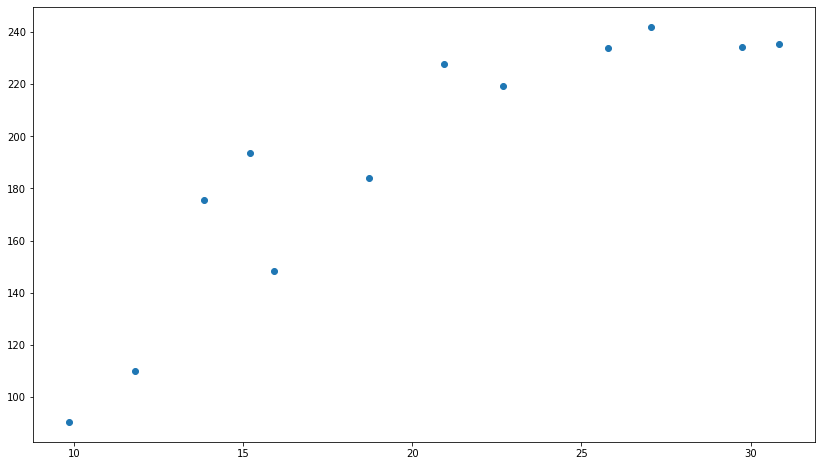

In [24]:
plt.scatter(x = tempM, y = countM)

Show the average of used bikes per season

In [25]:
year11 = pd.date_range('2011-01-01 ' ,'2011-02-01')
year11 = bikes.loc['2011-01-01 00:00:00' : '2011-12-31 00:00:00']

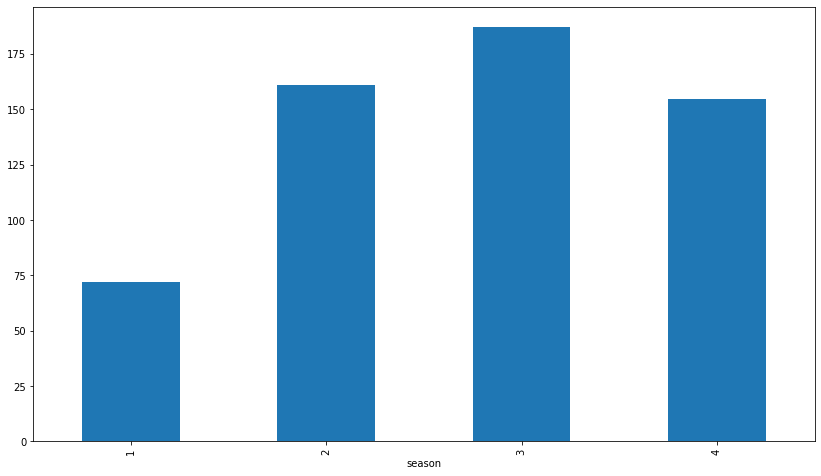

In [26]:
season = year11.groupby('season').mean()
season['count'].plot.bar()

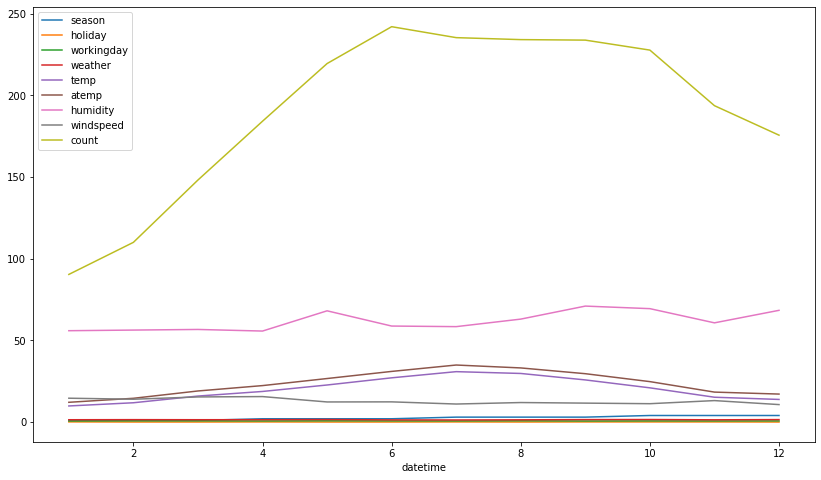

In [27]:
bikes.groupby(months).mean().plot()

In [28]:
bikes['year']= bikes.index.hour

In [29]:
weekdays = bikes.index.weekday
weekdays

Int64Index([5, 5, 5, 5, 5, 5, 5, 5, 5, 5,
            ...
            2, 2, 2, 2, 2, 2, 2, 2, 2, 2],
           dtype='int64', name='datetime', length=10886)

In [30]:
mWeekD = bikes.groupby(weekdays).mean()
mWeekD

,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,count,year
datetime,,,,,,,,,,
0,2.560284,0.154094,0.845906,1.398453,20.620542,24.178507,62.508059,12.921691,190.390716,11.549968
1,2.511371,0.000000,1.000000,1.510721,20.732307,24.252898,63.662768,13.338829,189.723847,11.596491
2,2.482914,0.015474,0.984526,1.501612,20.323417,23.764271,64.299162,12.635379,188.411348,11.548678
3,2.480361,0.000000,1.000000,1.377978,20.251835,23.641465,58.397939,13.138079,197.296201,11.537669
4,2.506867,0.031393,0.968607,1.368215,19.993198,23.066609,59.913015,12.398527,197.844343,11.535644
5,2.500000,0.000000,0.000000,1.393939,19.668611,23.121266,61.253157,12.670136,196.665404,11.500000
6,2.504750,0.000000,0.000000,1.379354,20.041963,23.569766,63.151995,12.499344,180.839772,11.524383


In [31]:
pd.date_range('2011-01-01 ', '2011-02-01', freq='D' )

DatetimeIndex(['2011-01-01', '2011-01-02', '2011-01-03', '2011-01-04',
               '2011-01-05', '2011-01-06', '2011-01-07', '2011-01-08',
               '2011-01-09', '2011-01-10', '2011-01-11', '2011-01-12',
               '2011-01-13', '2011-01-14', '2011-01-15', '2011-01-16',
               '2011-01-17', '2011-01-18', '2011-01-19', '2011-01-20',
               '2011-01-21', '2011-01-22', '2011-01-23', '2011-01-24',
               '2011-01-25', '2011-01-26', '2011-01-27', '2011-01-28',
               '2011-01-29', '2011-01-30', '2011-01-31', '2011-02-01'],
              dtype='datetime64[ns]', freq='D')

In [32]:
bikes.loc['2011-01-01 07:00:00' : '2011-02-01 10:00:00']

,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,count,year
datetime,,,,,,,,,,
2011-01-01 07:00:00,1,0,0,1,8.20,12.880,86,0.0000,3,7
2011-01-01 08:00:00,1,0,0,1,9.84,14.395,75,0.0000,8,8
2011-01-01 09:00:00,1,0,0,1,13.12,17.425,76,0.0000,14,9
2011-01-01 10:00:00,1,0,0,1,15.58,19.695,76,16.9979,36,10
2011-01-01 11:00:00,1,0,0,1,14.76,16.665,81,19.0012,56,11
...,...,...,...,...,...,...,...,...,...,...
2011-02-01 06:00:00,1,0,1,3,5.74,10.605,93,0.0000,22,6
2011-02-01 07:00:00,1,0,1,3,6.56,11.365,93,0.0000,52,7
2011-02-01 08:00:00,1,0,1,3,6.56,11.365,93,0.0000,135,8


In [33]:
bikes['hour']= bikes.index.hour # creates a new column 
bikes['hour'].dtype

dtype('int64')

In [34]:
bikes['months'] = bikes.index.month

In [35]:
bikes['day']= bikes.index.day
bikes

,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,count,year,hour,months,day
datetime,,,,,,,,,,,,,
2011-01-01 00:00:00,1,0,0,1,9.84,14.395,81,0.0000,16,0,0,1,1
2011-01-01 01:00:00,1,0,0,1,9.02,13.635,80,0.0000,40,1,1,1,1
2011-01-01 02:00:00,1,0,0,1,9.02,13.635,80,0.0000,32,2,2,1,1
2011-01-01 03:00:00,1,0,0,1,9.84,14.395,75,0.0000,13,3,3,1,1
2011-01-01 04:00:00,1,0,0,1,9.84,14.395,75,0.0000,1,4,4,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2012-12-19 19:00:00,4,0,1,1,15.58,19.695,50,26.0027,336,19,19,12,19
2012-12-19 20:00:00,4,0,1,1,14.76,17.425,57,15.0013,241,20,20,12,19
2012-12-19 21:00:00,4,0,1,1,13.94,15.910,61,15.0013,168,21,21,12,19


In [36]:
bikes['rushhour'] = bikes['hour'].between(12, 16)
bikes

,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,count,year,hour,months,day,rushhour
datetime,,,,,,,,,,,,,,
2011-01-01 00:00:00,1,0,0,1,9.84,14.395,81,0.0000,16,0,0,1,1,False
2011-01-01 01:00:00,1,0,0,1,9.02,13.635,80,0.0000,40,1,1,1,1,False
2011-01-01 02:00:00,1,0,0,1,9.02,13.635,80,0.0000,32,2,2,1,1,False
2011-01-01 03:00:00,1,0,0,1,9.84,14.395,75,0.0000,13,3,3,1,1,False
2011-01-01 04:00:00,1,0,0,1,9.84,14.395,75,0.0000,1,4,4,1,1,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2012-12-19 19:00:00,4,0,1,1,15.58,19.695,50,26.0027,336,19,19,12,19,False
2012-12-19 20:00:00,4,0,1,1,14.76,17.425,57,15.0013,241,20,20,12,19,False
2012-12-19 21:00:00,4,0,1,1,13.94,15.910,61,15.0013,168,21,21,12,19,False


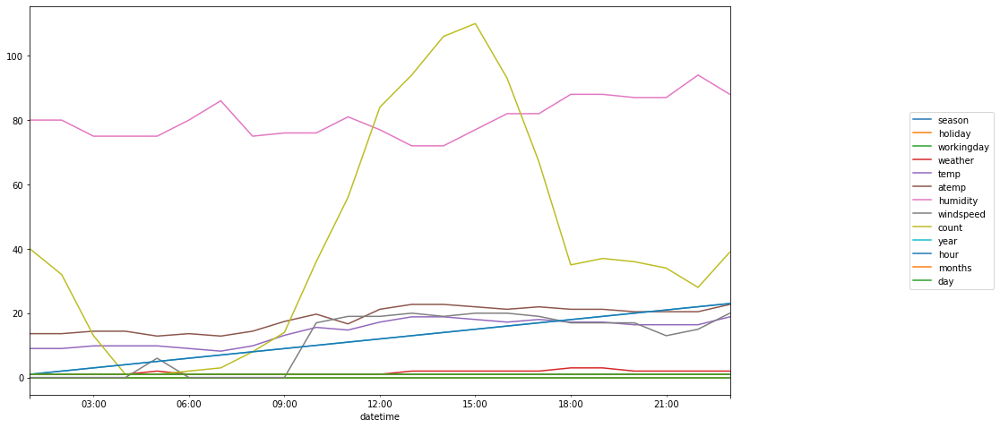

In [37]:
bikes.loc['2011-01-01 01:00:00' : '2011-01-01 23:00:00'].plot().legend(loc='center left', bbox_to_anchor=(1.25, 0.5), ncol=1)

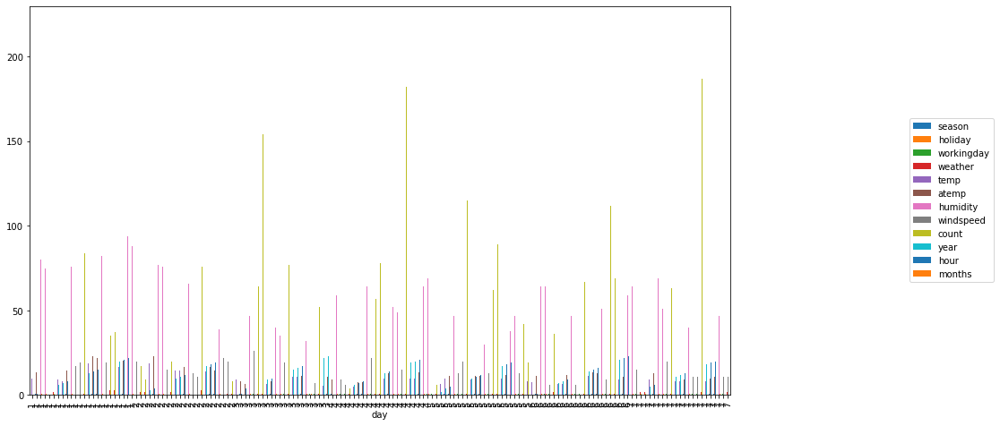

In [38]:
bikes.loc['2011-01-01' : '2011-01-07'].plot.bar(x = 'day').legend(loc='center left', bbox_to_anchor=(1.25, 0.5), ncol=1)

In [39]:
weekdays = bikes.index.day_name()

In [40]:
means = bikes.groupby(weekdays).mean()
means = means.loc[['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday']]

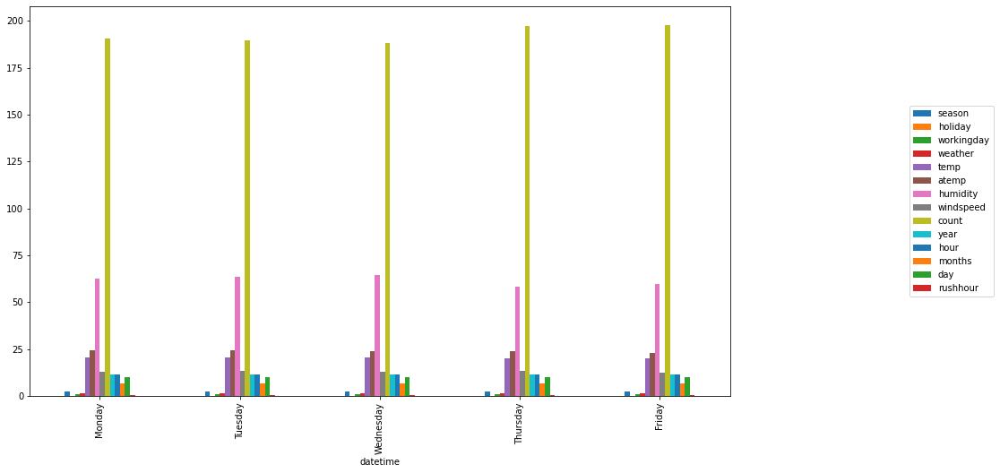

In [41]:
means.plot.bar().legend(loc='center left', bbox_to_anchor=(1.25, 0.5), ncol=1)

This plot tells us that the peak hour for bikes used is between 2-4pm

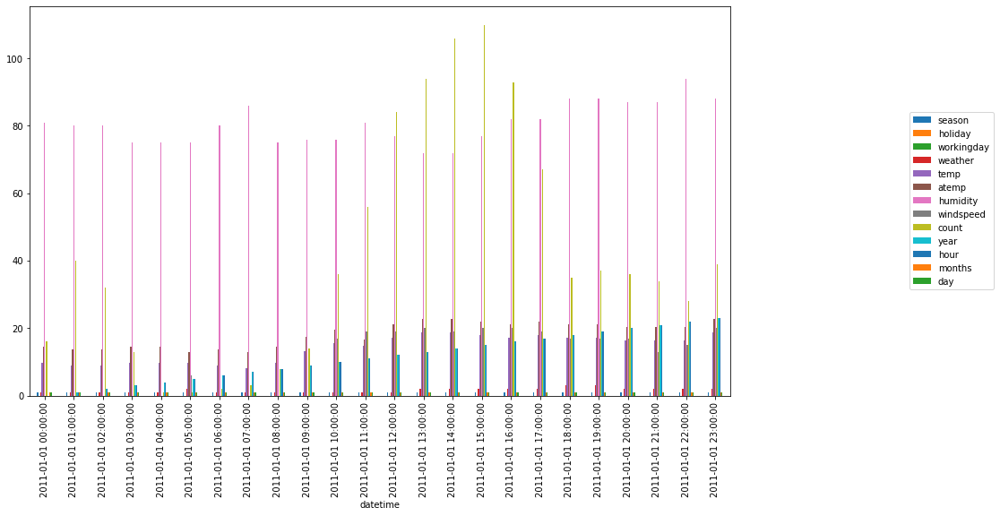

In [42]:
bikes.loc['2011-01-01' : '2011-01-01'].plot.bar().legend(loc='center left', bbox_to_anchor=(1.25, 0.5), ncol=1)

<Figure size 1440x720 with 0 Axes>

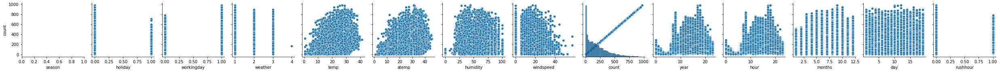

In [43]:
plt.figure(figsize=(20,10))
sns.pairplot(data=bikes, y_vars=['count'], x_vars=bikes.columns)

Polinomial Features

In [44]:
bikes['poly'] = bikes['temp']**2
bikes

,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,count,year,hour,months,day,rushhour,poly
datetime,,,,,,,,,,,,,,,
2011-01-01 00:00:00,1,0,0,1,9.84,14.395,81,0.0000,16,0,0,1,1,False,96.8256
2011-01-01 01:00:00,1,0,0,1,9.02,13.635,80,0.0000,40,1,1,1,1,False,81.3604
2011-01-01 02:00:00,1,0,0,1,9.02,13.635,80,0.0000,32,2,2,1,1,False,81.3604
2011-01-01 03:00:00,1,0,0,1,9.84,14.395,75,0.0000,13,3,3,1,1,False,96.8256
2011-01-01 04:00:00,1,0,0,1,9.84,14.395,75,0.0000,1,4,4,1,1,False,96.8256
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2012-12-19 19:00:00,4,0,1,1,15.58,19.695,50,26.0027,336,19,19,12,19,False,242.7364
2012-12-19 20:00:00,4,0,1,1,14.76,17.425,57,15.0013,241,20,20,12,19,False,217.8576
2012-12-19 21:00:00,4,0,1,1,13.94,15.910,61,15.0013,168,21,21,12,19,False,194.3236


In [45]:
poly = PolynomialFeatures(interaction_only=True)
poly.fit_transform(bikes)

array([[1.0000000e+00, 1.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
        9.6825600e+01, 0.0000000e+00],
       [1.0000000e+00, 1.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
        8.1360400e+01, 0.0000000e+00],
       [1.0000000e+00, 1.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
        8.1360400e+01, 0.0000000e+00],
       ...,
       [1.0000000e+00, 4.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
        3.6921484e+03, 0.0000000e+00],
       [1.0000000e+00, 4.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
        3.6921484e+03, 0.0000000e+00],
       [1.0000000e+00, 4.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
        3.2705536e+03, 0.0000000e+00]])

Feautre Engineering

In [46]:
bikes['daynr'] = pd.cut(bikes['day'], 7, labels =[1,2,3,4,5,6,7])

In [47]:
bikes.index = pd.to_datetime(bikes.index)

In [48]:
bikes.index.isna().any()

False

Training Model

In [49]:
X_train = bikes[['poly','season', 'rushhour', 'day']]
y_train = bikes['count']
y_train.shape, X_train.shape

((10886,), (10886, 4))

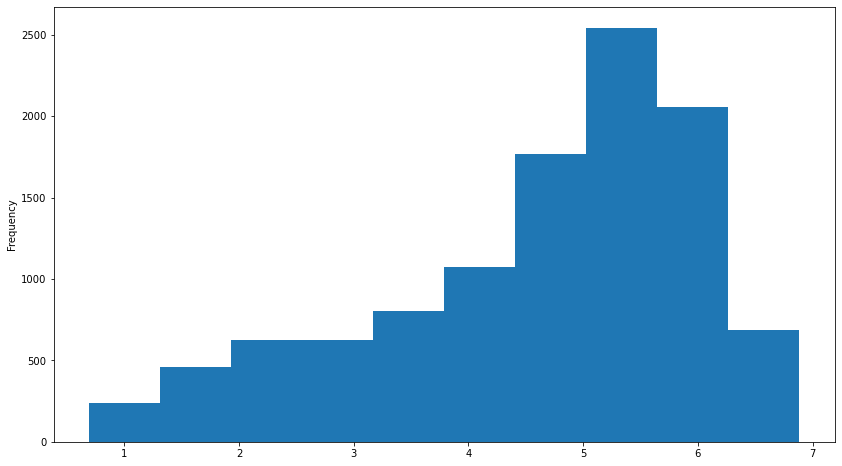

In [50]:
np.log1p(bikes['count']).plot(kind='hist')

In [51]:
Saturday = bikes[['day', 'poly'][::6]]
Saturday.shape

(10886, 1)

In [52]:
mlog = LinearRegression()
mlog.fit(X_train, np.log1p(bikes['count']))

LinearRegression()

In [54]:
ypred_log_count = mlog.predict(X_train)
ypredEx = np.exp(ypred_log_count)
ypredEx

array([40.15328664, 39.341747  , 39.341747  , ..., 72.23465115,
       72.23465115, 70.14919721])

In [55]:
m = LinearRegression()
m.fit(X_train, y_train)

LinearRegression()

In [56]:
ypred = m.predict(X_train)
ypred

array([ 77.56394272,  74.5661459 ,  74.5661459 , ..., 152.14599525,
       152.14599525, 147.8448085 ])

In [57]:
x1 = Saturday
mx1 = LinearRegression()
mx1.fit(x1, y_train)
ypredSat = mx1.predict(x1)
ypredSat

array([185.67718937, 185.67718937, 185.67718937, ..., 197.48083312,
       197.48083312, 197.48083312])

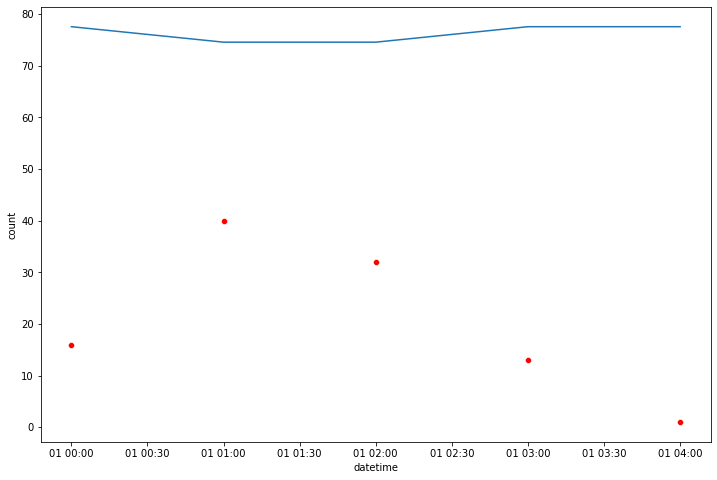

In [58]:
plt.figure(figsize=(12, 8))
sns.lineplot(X_train.index[:5], y=ypred[:5])
sns.scatterplot( x=X_train.index[:5], y=y_train[:5], color='r')

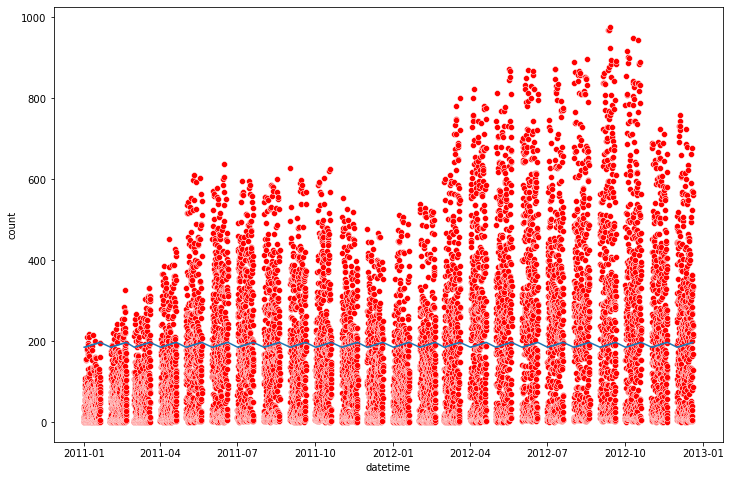

In [59]:
plt.figure(figsize=(12, 8))
sns.lineplot(x1.index, y=ypredSat)
sns.scatterplot( x1.index, y=y_train, color='r')

In [60]:
print(f' The accuracy of our Linear Regression model is {round(m.score(X_train,y_train),2)}')

 The accuracy of our Linear Regression model is 0.18


In [61]:
print(f' The accuracy of our Linear Regression model predicting for Saturday is {round(mx1.score(x1,y_train),2)}')

 The accuracy of our Linear Regression model predicting for Saturday is 0.0


In [62]:
y_train.mean()

191.57413191254824

In [63]:
w1 = m.coef_
w1 # slope to be calculated in gradient boosting?

array([ 0.19384145, 14.30826171, 65.62376333,  0.70878408])

In [64]:
w0 = m.intercept_
w0

43.77808203794126

In [65]:
model = CatBoostRegressor(iterations=10,
                          learning_rate=1,
                          depth=5)

In [66]:
model.fit(X_train, y_train)

0:	learn: 162.4753334	total: 57.8ms	remaining: 520ms
1:	learn: 159.5149796	total: 64.3ms	remaining: 257ms
2:	learn: 159.1956583	total: 74.4ms	remaining: 174ms
3:	learn: 158.2906815	total: 95.2ms	remaining: 143ms
4:	learn: 157.5638654	total: 114ms	remaining: 114ms
5:	learn: 157.0626839	total: 124ms	remaining: 82.6ms
6:	learn: 156.5907678	total: 141ms	remaining: 60.2ms
7:	learn: 156.1604010	total: 153ms	remaining: 38.2ms
8:	learn: 155.8420738	total: 159ms	remaining: 17.6ms
9:	learn: 155.6791853	total: 163ms	remaining: 0us


In [67]:
print(f' The accuracy of our GradientBooster is {round(model.score(X_train,y_train),2)}')

 The accuracy of our GradientBooster is 0.26


In [68]:
ypredCat = model.predict(X_train)
ypredCat

array([ 54.13521014,  54.13521014,  54.13521014, ..., 174.10223577,
       174.10223577, 174.10223577])

Plots the data against predicted bike usage from Gradient Bosst and Linear Regression model. In Seasons across two years

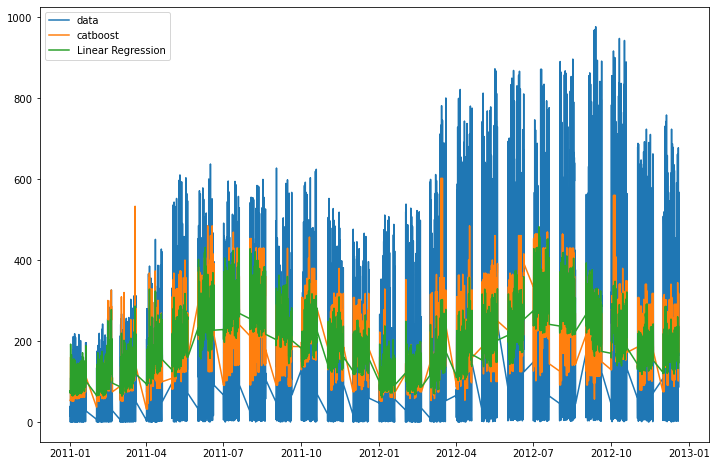

In [69]:
plt.figure(figsize=(12,8))
plt.plot(y_train)
plt.plot(X_train.index, ypredCat)
plt.plot(X_train.index, ypred)
plt.legend(['data','catboost','Linear Regression'])

Plots the data against predicted bike usage from Gradient Boost and Linear Regression model. In Seasons across two years on every Saturday

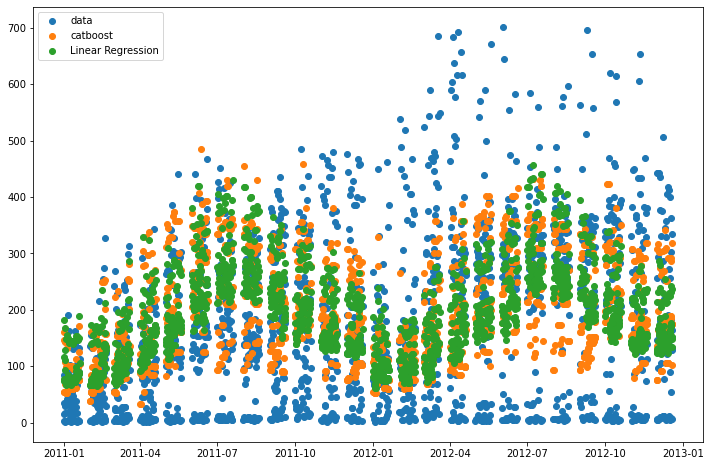

In [70]:
plt.figure(figsize=(12,8))
plt.scatter(X_train.index[::6],y_train[::6])
plt.scatter(X_train.index[::6], ypredCat[::6])
plt.scatter(X_train.index[::6], ypred[::6])
plt.legend(['data','catboost','Linear Regression'])

Plots the data against predicted bike usage from Gradient Boost and Linear Regression model. For every second Saturday in each Seasons across two years

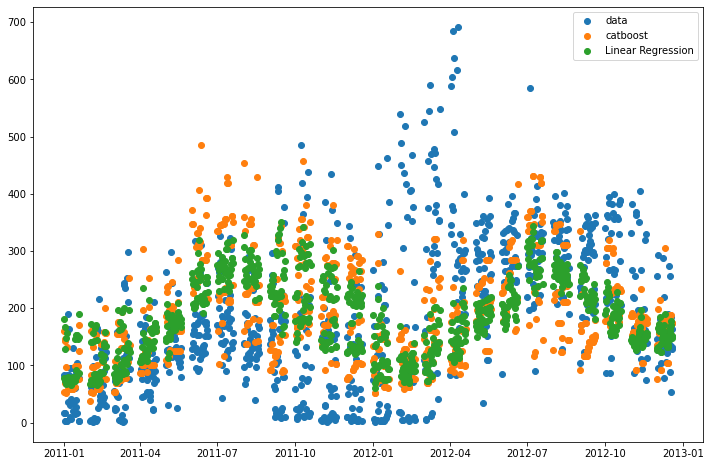

In [71]:
plt.figure(figsize=(12,8))
plt.scatter(X_train.index[::12],y_train[::12])
plt.scatter(X_train.index[::12], ypredCat[::12])
plt.scatter(X_train.index[::12], ypred[::12])
plt.legend(['data','catboost','Linear Regression'])

### Based on the Data exploration and the predictions made through the Linear Regression model and Gradient Boosting, we can gather that we need approximately 300 bikes ready to be used for this Saturday at 2pm

In [72]:
#accuracy = cross_validate(m, X_train, y_train, cv=5, scoring=['accuracy'])
#print(cross_validate, accuracy)

Testing the model

In [73]:
#loading test df
test = pd.read_csv ('/mnt/c/Users/noram/Documents/Coding/SpicedAcademy/Week03/test.csv', sep=',', parse_dates=True, index_col=0)
test.head()

,season,holiday,workingday,weather,temp,atemp,humidity,windspeed
datetime,,,,,,,,
2011-01-20 00:00:00,1,0,1,1,10.66,11.365,56,26.0027
2011-01-20 01:00:00,1,0,1,1,10.66,13.635,56,0.0000
2011-01-20 02:00:00,1,0,1,1,10.66,13.635,56,0.0000
2011-01-20 03:00:00,1,0,1,1,10.66,12.880,56,11.0014
2011-01-20 04:00:00,1,0,1,1,10.66,12.880,56,11.0014


In [74]:
test['poly'] = test['temp']**2
test

,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,poly
datetime,,,,,,,,,
2011-01-20 00:00:00,1,0,1,1,10.66,11.365,56,26.0027,113.6356
2011-01-20 01:00:00,1,0,1,1,10.66,13.635,56,0.0000,113.6356
2011-01-20 02:00:00,1,0,1,1,10.66,13.635,56,0.0000,113.6356
2011-01-20 03:00:00,1,0,1,1,10.66,12.880,56,11.0014,113.6356
2011-01-20 04:00:00,1,0,1,1,10.66,12.880,56,11.0014,113.6356
...,...,...,...,...,...,...,...,...,...
2012-12-31 19:00:00,1,0,1,2,10.66,12.880,60,11.0014,113.6356
2012-12-31 20:00:00,1,0,1,2,10.66,12.880,60,11.0014,113.6356
2012-12-31 21:00:00,1,0,1,1,10.66,12.880,60,11.0014,113.6356


In [75]:
test['day'] = test.index.day
test['hour'] = test.index.hour

In [76]:
poly_test = PolynomialFeatures(interaction_only=True)
poly_test.fit_transform(bikes)

array([[1.0000000e+00, 1.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
        0.0000000e+00, 9.6825600e+01],
       [1.0000000e+00, 1.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
        0.0000000e+00, 8.1360400e+01],
       [1.0000000e+00, 1.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
        0.0000000e+00, 8.1360400e+01],
       ...,
       [1.0000000e+00, 4.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
        0.0000000e+00, 1.3602652e+03],
       [1.0000000e+00, 4.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
        0.0000000e+00, 1.3602652e+03],
       [1.0000000e+00, 4.0000000e+00, 0.0000000e+00, ..., 0.0000000e+00,
        0.0000000e+00, 1.2049408e+03]])

In [77]:
test['rushhour'] = test['hour'].between(12, 16)
test

,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,poly,day,hour,rushhour
datetime,,,,,,,,,,,,
2011-01-20 00:00:00,1,0,1,1,10.66,11.365,56,26.0027,113.6356,20,0,False
2011-01-20 01:00:00,1,0,1,1,10.66,13.635,56,0.0000,113.6356,20,1,False
2011-01-20 02:00:00,1,0,1,1,10.66,13.635,56,0.0000,113.6356,20,2,False
2011-01-20 03:00:00,1,0,1,1,10.66,12.880,56,11.0014,113.6356,20,3,False
2011-01-20 04:00:00,1,0,1,1,10.66,12.880,56,11.0014,113.6356,20,4,False
...,...,...,...,...,...,...,...,...,...,...,...,...
2012-12-31 19:00:00,1,0,1,2,10.66,12.880,60,11.0014,113.6356,31,19,False
2012-12-31 20:00:00,1,0,1,2,10.66,12.880,60,11.0014,113.6356,31,20,False
2012-12-31 21:00:00,1,0,1,1,10.66,12.880,60,11.0014,113.6356,31,21,False


In [78]:
test.isna().any()

season        False
holiday       False
workingday    False
weather       False
temp          False
atemp         False
humidity      False
windspeed     False
poly          False
day           False
hour          False
rushhour      False
dtype: bool

In [79]:
x_test = test[['poly','season', 'rushhour', 'day']]

In [80]:
ypredTest = mlog.predict(x_test)
ypredTest = np.expm1(ypredTest)
ypredTest

array([44.36847244, 44.36847244, 44.36847244, ..., 47.07035151,
       47.07035151, 47.07035151])

In [81]:
ypredCat_test = model.predict(x_test)
ypredCat_test

array([75.75608065, 75.75608065, 75.75608065, ..., 75.75608065,
       75.75608065, 75.75608065])

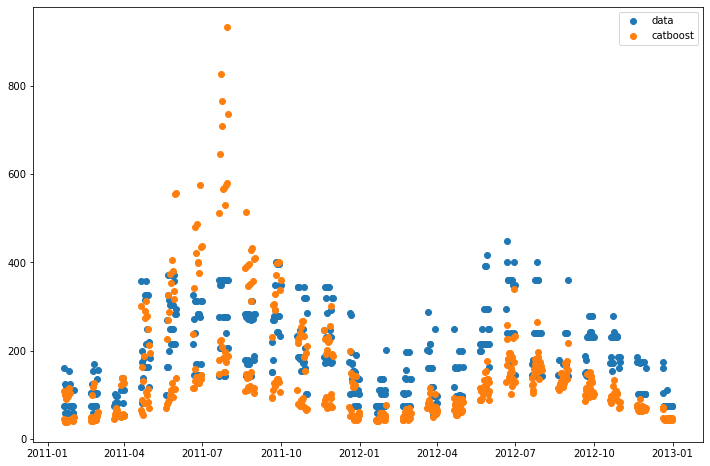

In [82]:
plt.figure(figsize=(12,8))
plt.scatter(x_test.index[::12], ypredCat_test[::12])
plt.scatter(x_test.index[::12], ypredTest[::12])
plt.legend(['data','catboost'])